In [1]:
import sys
import os
import pandas as pd
import numpy as np
from sklearn.base import clone
from sklearn.pipeline import make_pipeline, make_union
from sklearn.compose import make_column_transformer
from sklearn.preprocessing import LabelEncoder, FunctionTransformer, PolynomialFeatures
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import Perceptron, LogisticRegression
from sklearn.decomposition import PCA
from sklearn.svm import SVC
from sklearn.semi_supervised import LabelPropagation, LabelSpreading, SelfTrainingClassifier
import eli5
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import cartopy.crs as ccrs
from cartopy.io.shapereader import Reader
from cartopy.mpl.ticker import LatitudeFormatter, LongitudeFormatter

sys.path.append(r'C:\Users\lerna\git\sinetym')
sys.path.append(r'C:\Users\lerna\git\sinetym\scripts')
import sinetym
from isogloss import isogloss

In [2]:
np.random.seed(7457)

plt.rcParams.update({
    'font.family': 'serif',
    'mathtext.fontset': 'dejavusans',
    'font.serif': ['simsun', 'AR PL UMing CN'],
    'axes.unicode_minus': False,
})

In [3]:
prefix = r'C:\Users\lerna\git\zhongguoyuyan\csv'
location = sinetym.datasets.zhongguoyuyan.load_location(os.path.join(prefix, 'location.csv'), predict=False)
background = plt.imread(r'C:\Users\lerna\data\natural_earth\raster\NE1_50M_SR_W\NE1_50M_SR_W.tif')
shp_prefix = r'C:\Users\lerna\git\ChinaAdminDivisonSHP'
china = Reader(os.path.join(shp_prefix, r'1. Country\country.shp'))

In [4]:
char = pd.read_csv(os.path.join(prefix, 'words.csv'), index_col='cid')
rule = sinetym.compare.load_rule(r'C:\Users\lerna\git\sinetym\data\mandarin.csv', characters=char['item'])
display(rule)

,element,cid1,cid2,name,char1,char2
0,tone,"[19, 26, 38, 79, 105, 111, 148, 159, 177, 199,...","[3, 39, 45, 48, 61, 106, 112, 121, 133, 150, 1...",坐=大,坐祸下户柱竖蟹弟罪被柿市跪抱造后厚舅淡犯件断近像上棒项静动重,大夏谢射步住树袋害败递系背会坏画话地字寺治事柜号校轿豆袖寿旧赚弹汗办便缠健现换传饭县恨顺撞剩...
1,tone,"[19, 26, 38, 79, 105, 111, 148, 159, 177, 199,...","[30, 141, 331, 369, 466, 556, 595, 724, 749, 8...",坐=马,坐祸下户柱竖蟹弟罪被柿市跪抱造后厚舅淡犯件断近像上棒项静动重,马买母有懒满软两痒猛冷领
2,tone,"[30, 141, 331, 369, 466, 556, 595, 724, 749, 8...","[5, 8, 17, 20, 21, 24, 28, 34, 40, 41, 43, 57,...",马=左,马买母有懒满软两痒猛冷领,左可躲锁果火把假哑姐写谱赌土古苦虎所鼠举府取数主改海摆解矮洗紫纸比死指子使喜几嘴水鬼宝讨早草...
3,final,"[119, 120, 121, 122, 123, 124]",[131],胎=带,胎台袋来菜财,带
4,final,"[374, 375, 376, 377]","[387, 389, 390, 391]",贪=胆,贪潭南蚕,胆淡蓝三
5,final,"[378, 379, 380]",[393],感=敢,感含暗,敢
6,final,"[93, 94, 96]","[113, 114, 115, 116, 117]",锯=句,锯去鱼,句区遇雨芋
7,final,"[86, 87]","[107, 108]",初=数,初锄,数数
8,final,"[778, 780, 781]","[733, 734, 735, 736, 737]",桩=装,桩窗双,装壮疮床霜
9,final,"[204, 223, 238, 239, 240]","[152, 153]",纸=制,纸指试时市,制世


In [5]:
norms = ('no', 'l1', 'l2')
compliances = [pd.read_csv(fr'C:\Users\lerna\git\sinetym\data\compliance_{norm}.csv', index_col='lid') for norm in norms]
for c, n in zip(compliances, norms):
    c.columns = n + '_' + rule.loc[c.columns.astype('int'), 'name']

In [6]:
rule.set_index('name', inplace=True)

In [7]:
data = pd.concat([location[['latitude', 'longitude', 'province', 'city', 'county', 'dialect', 'cluster', 'subcluster']]] + compliances, axis=1)
data.insert(0, 'name', data['city'] + data['county'])
data.loc[data['dialect'] != '', 'code'] = LabelEncoder().fit_transform(data.loc[data['dialect'] != '', 'dialect'])

In [8]:
display(sinetym.plot.geography.interactive(
    data['latitude'],
    data['longitude'],
    data.filter(regex=r'^l[12]_坐=大'),
    # data.filter(regex=r'^l[12]_.+=.+'),
    tips={
        'lid': data.index,
        'city': data['city'],
        'county': data['county'],
        'dialect': data['dialect'],
        'cluster': data['cluster'],
        'subcluster': data['subcluster']
    },
    cmap='coolwarm'
))

l1_胎=带


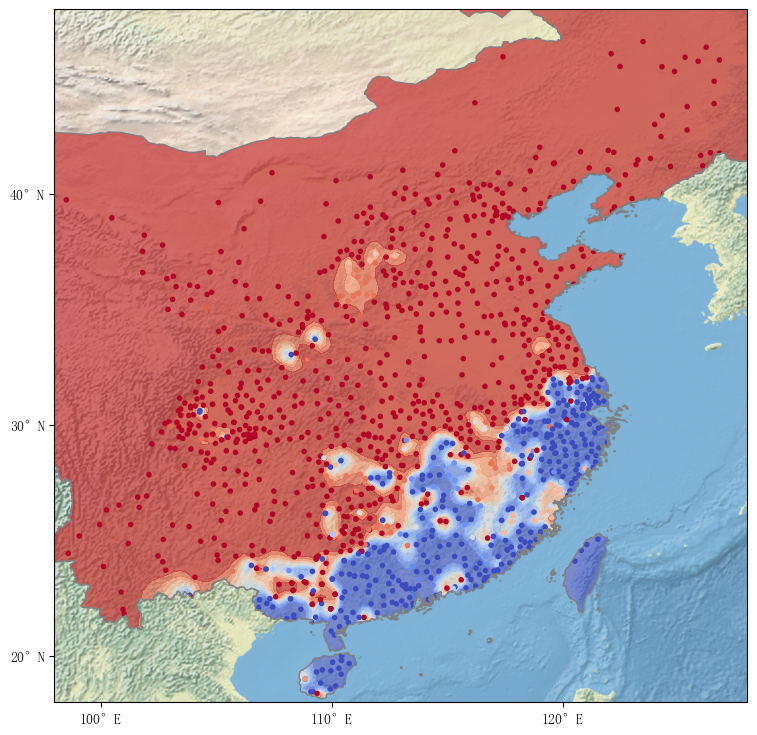

l2_胎=带


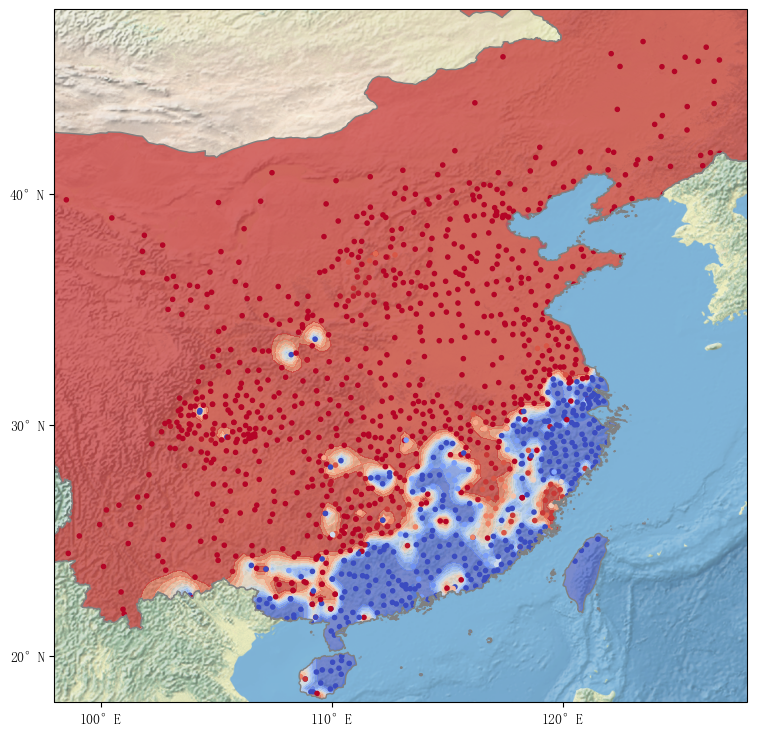

l1_柄=冰


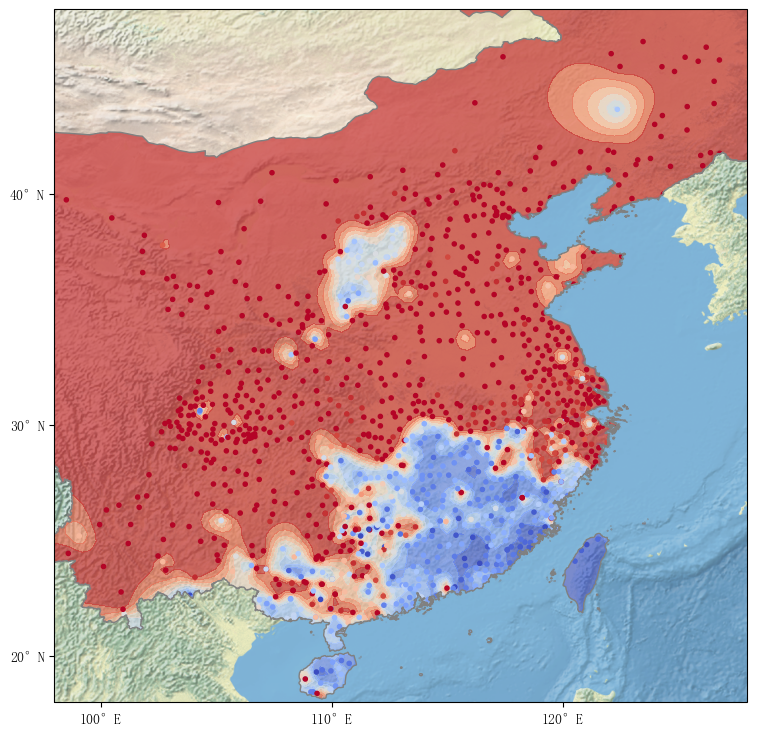

l2_柄=冰


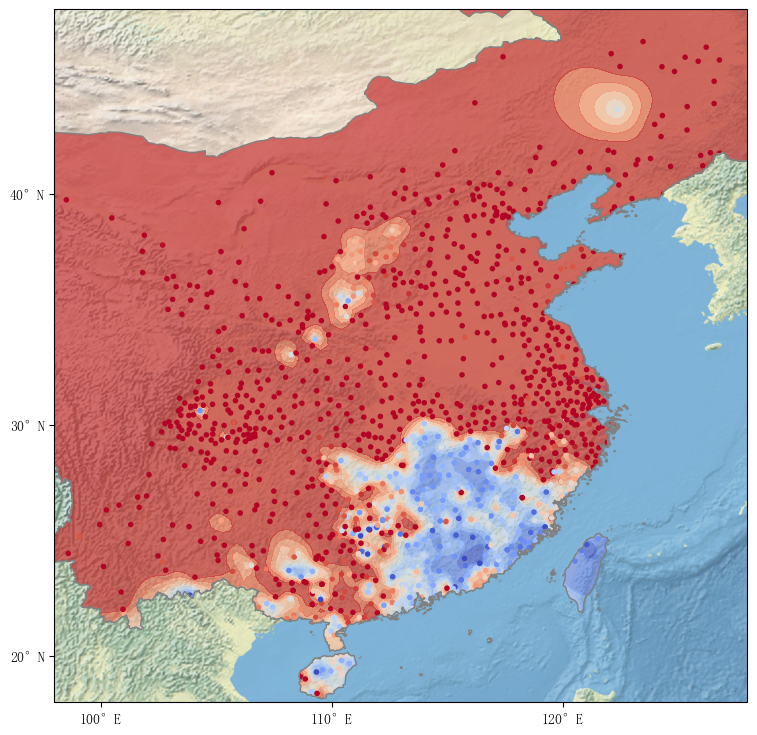

l2_贪=胆


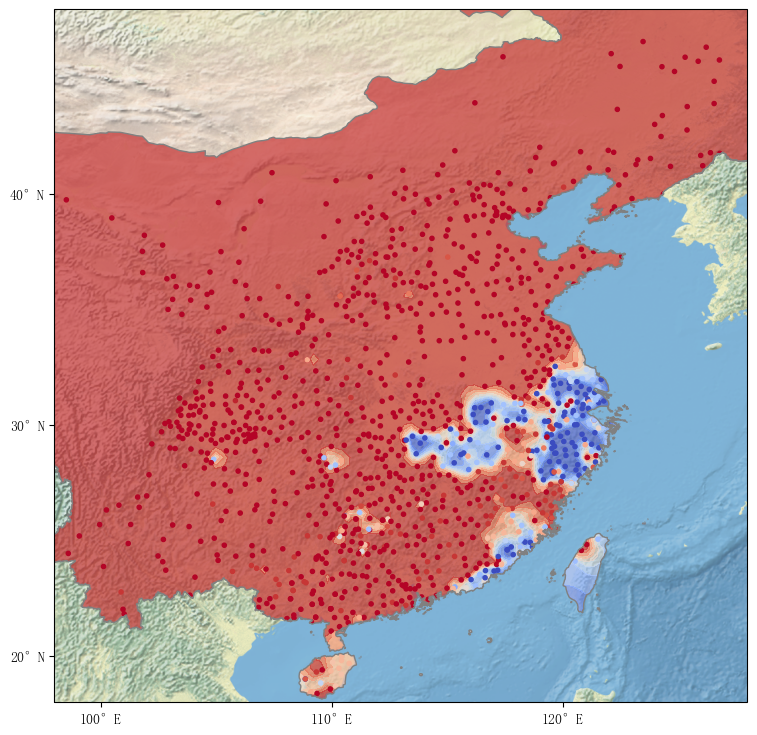

l2_斜=写


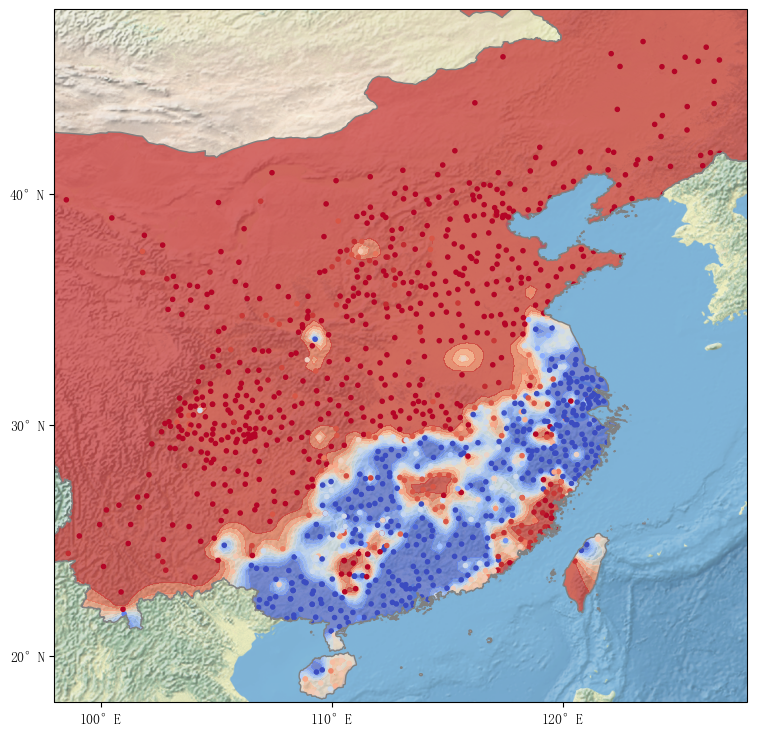

l2_谢=写


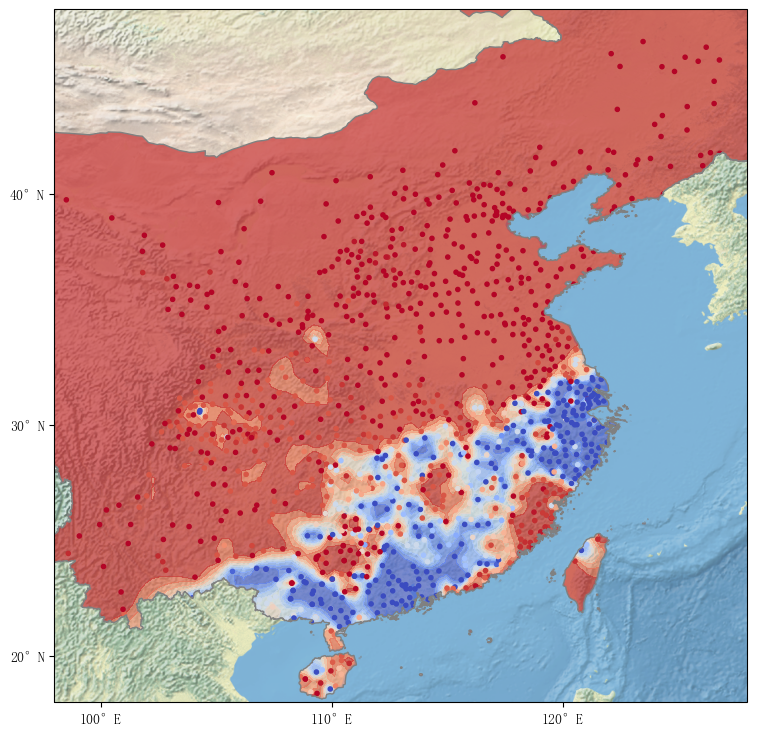

l2_船=射


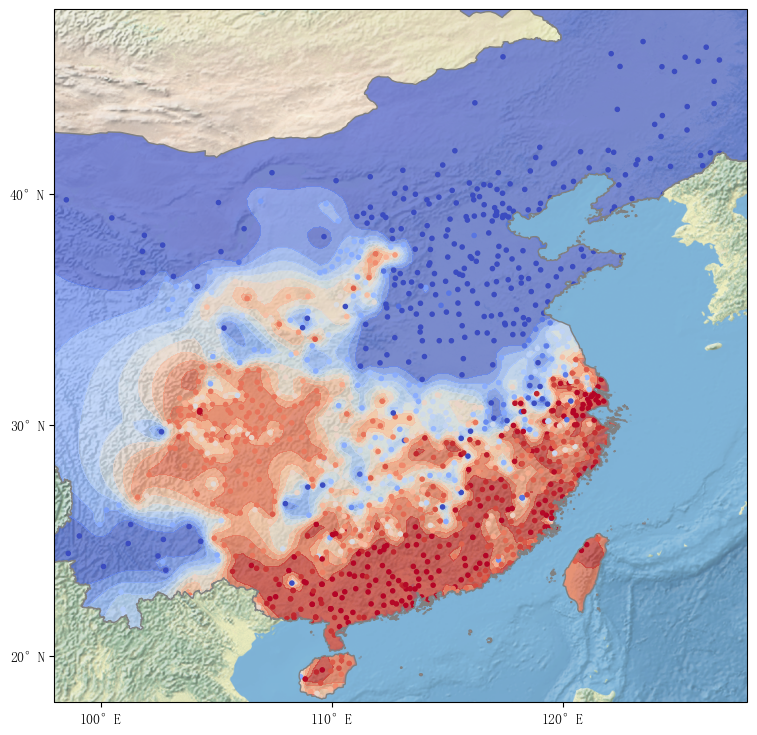

In [9]:
extent = [98, 128, 18, 48]

for r in ('l1_胎=带', 'l2_胎=带', 'l1_柄=冰', 'l2_柄=冰', 'l2_贪=胆', 'l2_斜=写', 'l2_谢=写', 'l2_船=射'):
    print(r)
    plt.figure(figsize=(16, 9))
    isogloss(
        data,
        'latitude',
        'longitude',
        r,
        extent=extent,
        background=background,
        geo=china.geometries()
    )
    plt.show()
    plt.close()

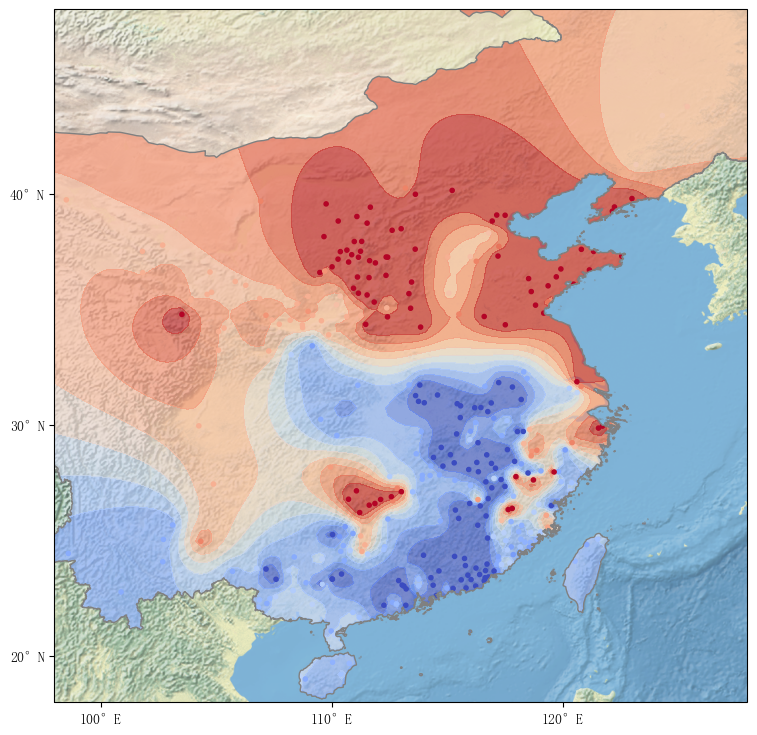

In [10]:
div = data['l2_纸=师'] / (data['l2_纸=师'] + data['l2_纸=知'])

plt.figure(figsize=(16, 9))
isogloss(
    data[(div - 0.5).abs() > 0.1].assign(value=div),
    'latitude',
    'longitude',
    'value',
    extent=extent,
    background=background,
    geo=china.geometries()
)
plt.show()
plt.close()

In [11]:
data.loc[[
    '06F90',    # 济南市区
    '24C62',    # 洛阳老城
    # '28999',    # 西安莲湖
    '10G68',    # 南京
    # '2839X',    # 延安延川
    # '01G17',    # 桂林市区
    '07242',    # 荆州
    '16303',    # 内江隆昌
    '26D40',    # 常德安乡
    '21A29',    # 芜湖
    '06K07',    # 烟台长岛
    '27C71',    # 科尔沁通辽
    # '12A94',    # 临汾隰县
    # '16C14',    # 乐山金口河
    # '28E76',    # 榆林吴堡
    '26504',    # 岳阳华容
    # '12D77',    # 大同新荣
    '26J55',    # 怀化新晃
    '10G79',    # 兴化
    # '11584',    # 邢台沙河
    # '12D83',    # 临汾蒲县
    # '12D87',    # 运城万荣
], 'class'] = '官话'
data.loc[[
    '02A05',    # 福州鼓楼
    '10G71',    # 苏州姑苏
    '21J03',    # 黄山徽州
    '15231',    # 广州荔湾
    '15233',    # 梅州梅江
    '18358',    # 南昌西湖
    # '21345',    # 潜山
    # '11067',    # 灌南
    '01G23',    # 南宁江南
    # '10G69',    # 南通
    # '35401',    # 茂名电白
    # '01J68',    # 百色平果
    '26D44',    # 永州东安
    '07903',    # 黄石大冶
    # '35410',    # 怀化通道
    '21A23',    # 安庆怀宁
    '01E10',    # 北海合浦
    '35407',    # 黔西南晴隆
    # '08207',    # 杭州上城
], 'class'] = '非官话'
data.loc[:, 'class'].fillna('', inplace=True)
data['label'] = data['class'].map({'官话': 1, '非官话': 0, '': -1})

In [12]:
features = (
    ('all', [
        '坐=大',
        '马=左',
        '胎=带',
        '贪=胆',
        '感=敢',
        '桩=装',
        '柄=冰',
        '程=证',
        '席=逼',
        '尺=直',
        '肥=肺',
        '谢=写',
        '河=海',
        '祸=火',
        '射=书',
        '坐=马',
        '谢=集'
    ]),
    ('basic', [
        '坐=大',
        '马=左',
        '胎=带',
        '贪=胆',
        '感=敢',
        '桩=装',
        '柄=冰',
        '程=证',
        '席=逼',
        '尺=直',
        '坐=马'
    ])
)

transformers = (
    ('no', FunctionTransformer(lambda x: x)),
    ('beta', make_union(
        FunctionTransformer(lambda x: np.log(x + 1e-5)),
        FunctionTransformer(lambda x: np.log(1 - x + 1e-5))
    )),
    ('diag_gaussian', make_union(
        'passthrough',
        FunctionTransformer(np.square)
    )),
    ('gaussian', PolynomialFeatures(degree=2, include_bias=False))
)

predictors = (
    ('nb', GaussianNB()),
    ('lr', LogisticRegression()),
    ('svm', SVC(kernel='linear', probability=True))
)

estimators = {}
for sim in ('l1', 'l2'):
    x = data.loc[:, [f'{sim}_{f}' for f in features[0][1]]]
    data[[f'{sim}_pc1', f'{sim}_pc2', f'{sim}_pc3']] = PCA(n_components=3).fit_transform(x)
    data[f'{sim}_label_propagation'] = LabelPropagation().fit(x, data['label']).transduction_
    data[f'{sim}_label_spreading'] = LabelSpreading(alpha=1e-5).fit(x, data['label']).transduction_

    for feature_name, fea in features:
        x = data.loc[:, [f'{sim}_{f}' for f in fea]]
        
        for transformer_name, transformer in transformers:
            transformer = clone(transformer)
            xt = transformer.fit_transform(x)

            for predictor_name, predictor in predictors:
                name = '_'.join((sim, feature_name, transformer_name, predictor_name))
                # estimator = SelfTrainingClassifier(predictor).fit(xt, data['label']).base_estimator_
                estimator = clone(predictor).fit(xt[data['label'] >= 0], data.loc[data['label'] >= 0, 'label'])
                estimators[name] = make_pipeline(transformer, estimator)
                data[f'{name}_prob'] = estimator.predict_proba(xt)[:, 1]

c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\semi_supervised\_label_propagation.py:314: ConvergenceWarning: max_iter=1000 was reached without convergence.
  warnings.warn(
c:\Users\lerna\AppData\Local\miniconda3\lib\site-packages\sklearn\semi_supervised\_label_propagation.py:314: ConvergenceWarning: max_iter=1000 was reached without convergence.
  warnings.warn(


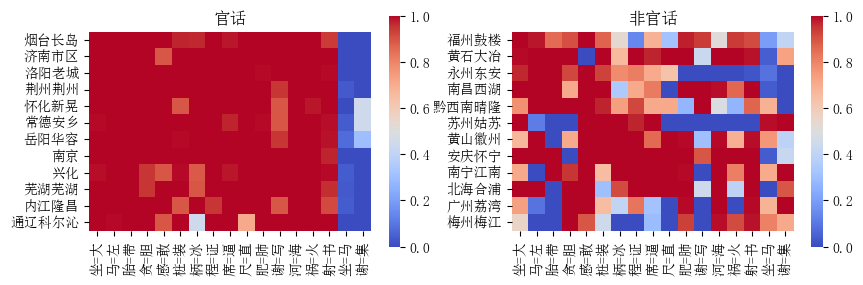

In [13]:
fig = plt.figure(figsize=(10, 3))

for i, cls in enumerate(('官话', '非官话')):
    ax = fig.add_subplot(1, 2, i + 1)

    sns.heatmap(
        data.loc[data['class'] == cls, [f'l2_{f}' for f in features[0][1]]],
        vmin=0,
        vmax=1,
        cmap='coolwarm',
        square=True,
        xticklabels=features[0][1],
        yticklabels=data.loc[data['class'] == cls, 'name'],
        ax=ax
    )
    ax.set_title(cls)

plt.show()

In [14]:
for sim in ('l1', 'l2'):
    fig = px.scatter_3d(
        data,
        x=f'{sim}_pc1',
        y=f'{sim}_pc2',
        z=f'{sim}_pc3',
        color='class',
        hover_name=data.index,
        hover_data=['name'],
        color_discrete_map={'官话': 'red', '非官话': 'blue', '': 'gray'}
    )
    fig.update_traces(marker={'size': 5})
    fig.show()

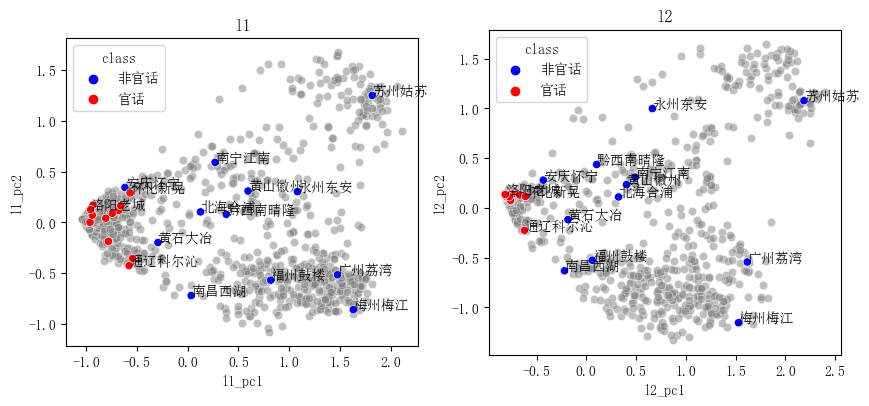

In [15]:
fig = plt.figure(figsize=(10, 5))

for i, sim in enumerate(('l1', 'l2')):
    ax = fig.add_subplot(1, 2, i + 1)
    sns.scatterplot(
        data[data['label'] == -1],
        x=f'{sim}_pc1',
        y=f'{sim}_pc2',
        ax=ax,
        color='gray',
        alpha=0.5
    )
    sns.scatterplot(
        data[data['label'] != -1],
        x=f'{sim}_pc1',
        y=f'{sim}_pc2',
        hue=data['class'],
        palette={'官话': 'red', '非官话': 'blue'},
        ax=ax
    )
    for i in (
        '24C62',    # 洛阳老城
        '27C71',    # 科尔沁通辽
        '26J55',    # 怀化新晃
        '02A05',    # 福州鼓楼
        '10G71',    # 苏州姑苏
        '21J03',    # 黄山徽州
        '15231',    # 广州荔湾
        '15233',    # 梅州梅江
        '18358',    # 南昌西湖
        '01G23',    # 南宁江南
        '26D44',    # 永州东安
        '07903',    # 黄石大冶
        '21A23',    # 安庆怀宁
        '01E10',    # 北海合浦
        '35407',    # 黔西南晴隆
    ):
        ax.annotate(data.loc[i, 'name'], xy=data.loc[i, [f'{sim}_pc1', f'{sim}_pc2']])
    ax.set_aspect('equal')
    ax.set_title(sim)

plt.show()

In [16]:
for sim in ('l1', 'l2'):
    for prob in data.filter(regex=f'^{sim}_all_.+_lr_prob$'):
        fig = px.scatter_3d(
            data,
            x=f'{sim}_pc1',
            y=f'{sim}_pc2',
            z=f'{sim}_pc3',
            color=prob,
            hover_name=data.index,
            hover_data=['name']
        )
        fig.update_traces(marker={'size': 5})
        fig.show()

In [17]:
display(sinetym.plot.geography.interactive(
    data['latitude'],
    data['longitude'],
    data.filter(regex=r'^l2_.+_lr_prob'),
    # data.filter(regex=r'.+_prob$'),
    tips={
        'lid': data.index,
        'city': data['city'],
        'county': data['county'],
        'dialect': data['dialect'],
        'cluster': data['cluster'],
        'subcluster': data['subcluster']
    },
    cmap='coolwarm'
))

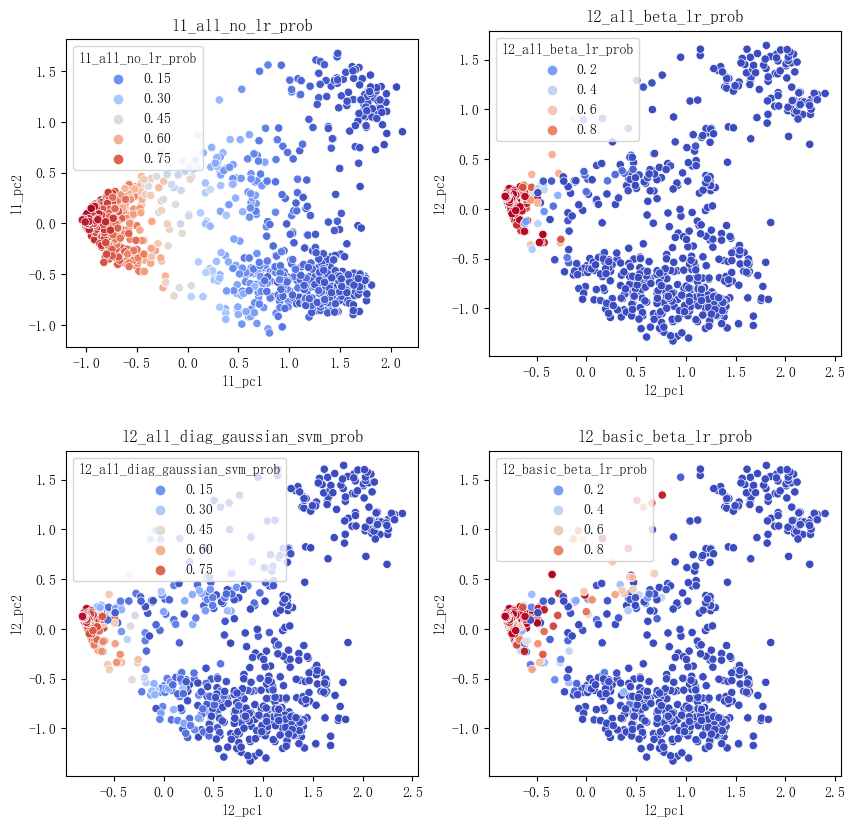

In [18]:
probs = (
    'l1_all_no_lr_prob',
    'l2_all_beta_lr_prob',
    'l2_all_diag_gaussian_svm_prob',
    'l2_basic_beta_lr_prob',
)

fig = plt.figure(figsize=(10, 10))
count = 0
for prob in probs:
    sim = prob.partition('_')[0]
    count += 1
    ax = fig.add_subplot((len(probs) + 1) // 2, 2, count)
    sns.scatterplot(data, x=f'{sim}_pc1', y=f'{sim}_pc2', hue=prob, palette='coolwarm', ax=ax, vmin=0, vmax=1)
    ax.set_title(prob)
    ax.set_aspect('equal')

plt.show()

In [19]:
for feature_name, feature in features:
    estimator = estimators[f'l2_{feature_name}_no_lr'].steps[1][1]
    display(eli5.show_weights(estimator, feature_names=feature, target_names=('非官话', '官话')))

    for lid in ('12D81', '12D83', '12D87', '10G69', '26509'):
        print(''.join(location.loc[lid, ['city', 'county']]))
        display(eli5.show_prediction(estimator, data.loc[lid, [f'l2_{f}' for f in feature]], feature_names=feature, target_names=('非官话', '官话')))

Weight?,Feature
+0.876,谢=写
+0.761,贪=胆
+0.743,尺=直
+0.733,祸=火
+0.571,胎=带
+0.514,柄=冰
+0.452,河=海
+0.446,程=证
+0.385,肥=肺
+0.366,席=逼


吕梁临县


临汾蒲县


运城万荣


南通


娄底双峰


Weight?,Feature
+0.848,胎=带
+0.822,尺=直
+0.790,贪=胆
+0.521,柄=冰
+0.503,席=逼
+0.490,马=左
+0.481,程=证
+0.462,桩=装
+0.446,感=敢
+0.324,坐=大


吕梁临县


临汾蒲县


运城万荣


南通


娄底双峰


In [20]:
def plot_dialect(data, col, background, clip, extent=[98, 128, 18, 48]):
    clip = tuple(clip)
    proj = ccrs.PlateCarree()
    ax = plt.axes(projection=proj)

    ax.imshow(
        background,
        transform=proj,
        extent=[-180, 180, -90, 90]
    )

    ax.add_geometries(clip, proj, edgecolor='gray', facecolor='none')

    ax, extent, qm = sinetym.plot.geography.area(
        data['latitude'],
        data['longitude'],
        values=data['code'],
        ax=ax,
        extent=extent,
        clip=clip,
        cmap='tab20',
        alpha=0.3
    )

    ax, extent, pc = sinetym.plot.geography.scatter(
        data['latitude'],
        data['longitude'],
        values=data[col],
        ax=ax,
        extent=extent,
        clip=clip,
        vmin=0,
        vmax=1,
        marker='.',
        cmap='coolwarm'
    )

    ax, extent, cs = sinetym.plot.geography.isogloss(
        data['latitude'],
        data['longitude'],
        values=data[col],
        ax=ax,
        fill=False,
        vmin=0,
        vmax=1,
        extent=extent,
        clip=clip,
        levels=[0.25, 0.5, 0.75]
    )

    left, right, bottom, top = extent
    step = max(right - left, top - bottom) / 5
    step = 1 if step <= 1 else 5 if step <= 5 else 10
    ax.set_xticks(np.arange(left // step, right // step + 1) * step, crs=proj)
    ax.set_yticks(np.arange(bottom // step, top // step + 1) * step, crs=proj)
    ax.set_extent(extent, crs=proj)
    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter())

    return ax

l1_all_no_lr_prob


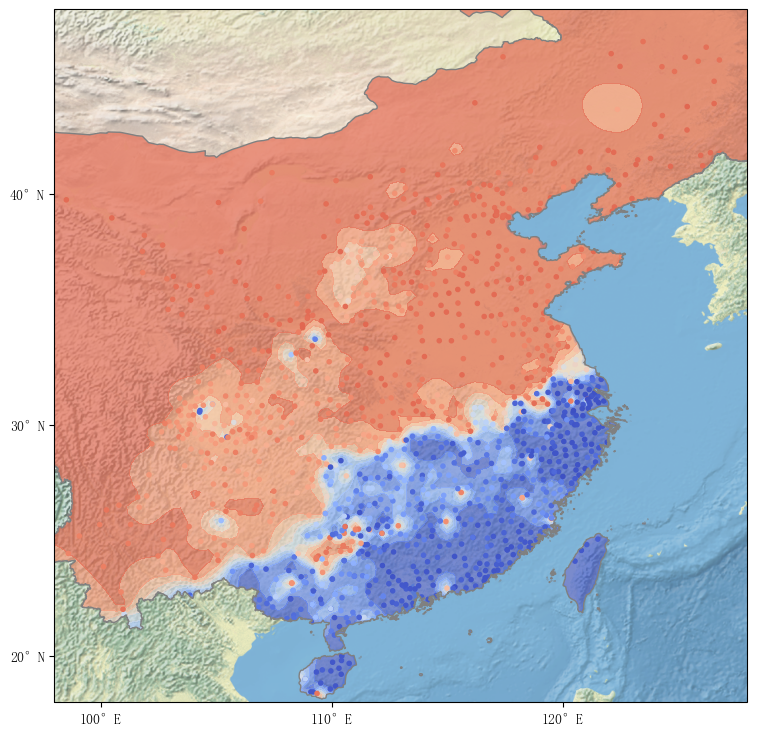

l2_all_beta_lr_prob


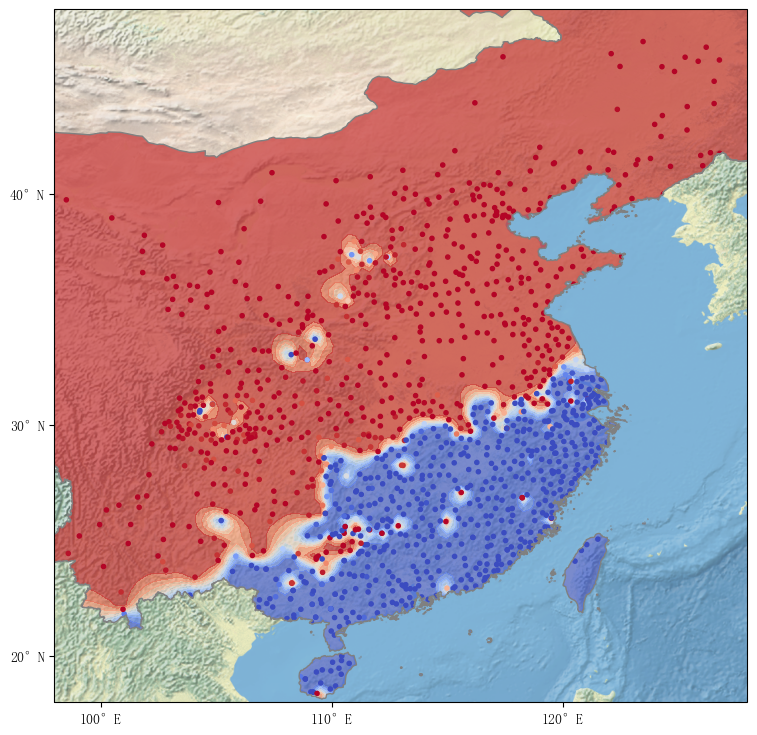

l2_all_diag_gaussian_svm_prob


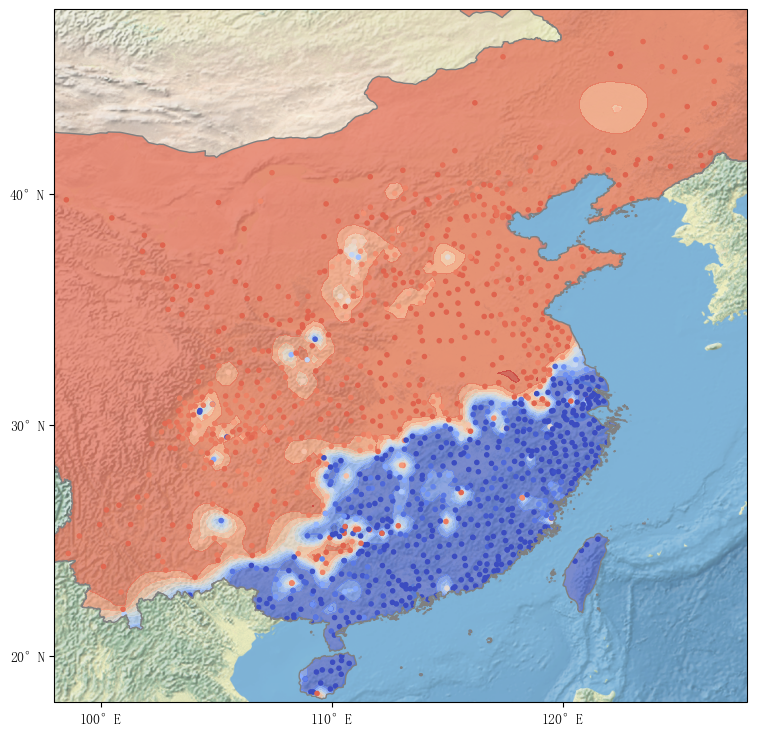

l2_basic_beta_lr_prob


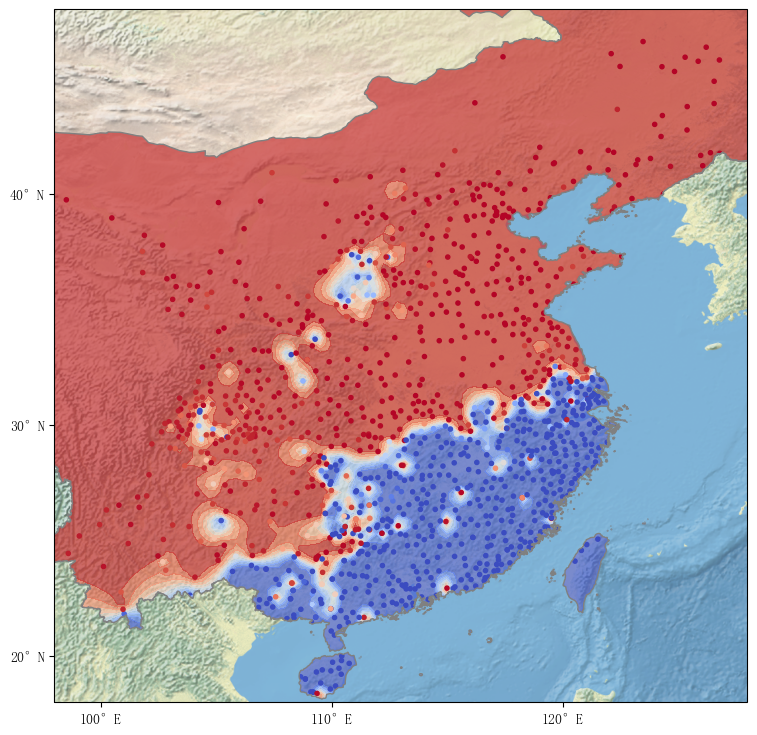

In [21]:
for prob in probs:
    print(prob)
    plt.figure(figsize=(16, 9))
    ax = isogloss(
        data,
        'latitude',
        'longitude',
        prob,
        extent=extent,
        background=background,
        geo=china.geometries()
    )
    plt.show()
    plt.close()

l2_all_beta_lr_prob


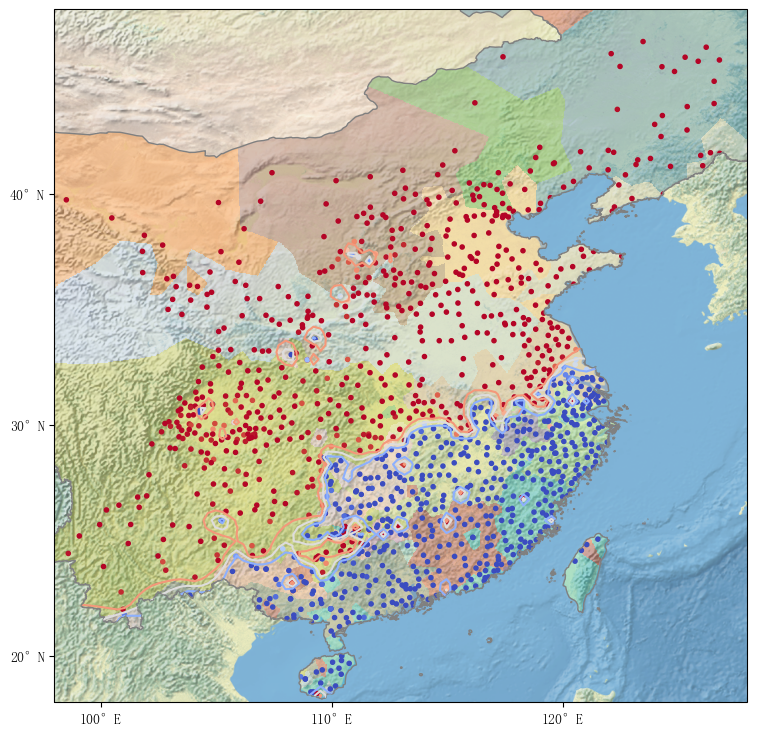

l2_basic_beta_lr_prob


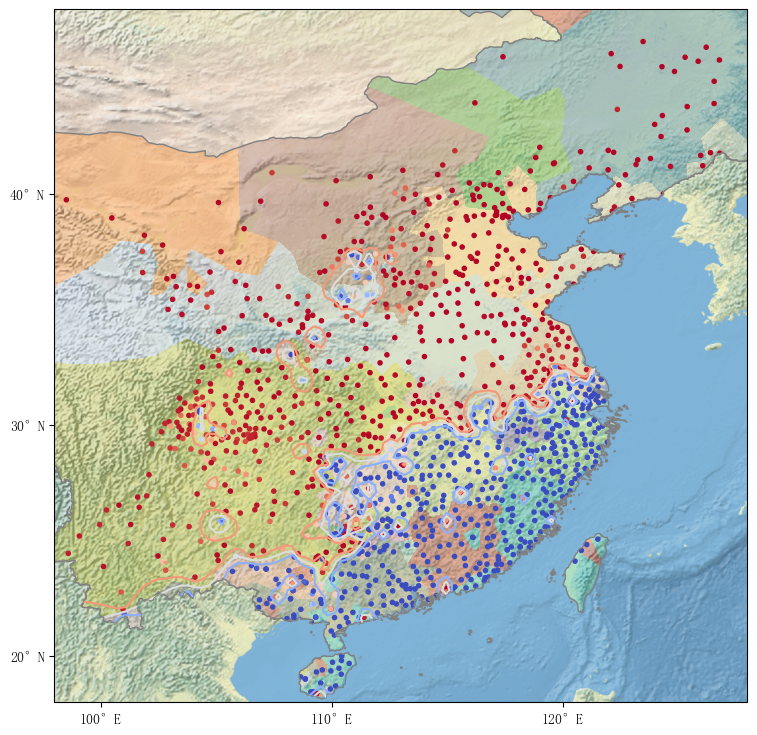

In [22]:
for prob in ['l2_all_beta_lr_prob', 'l2_basic_beta_lr_prob']:
    print(prob)
    plt.figure(figsize=(16, 9))
    ax = plot_dialect(data, prob, background, china.geometries())
    plt.show()
    plt.close()

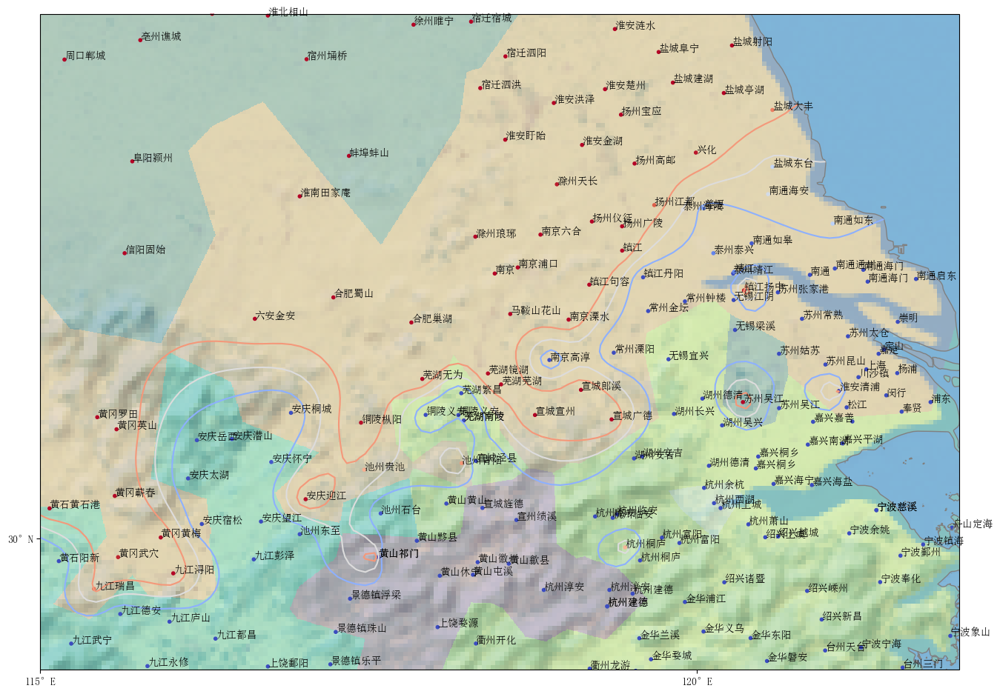

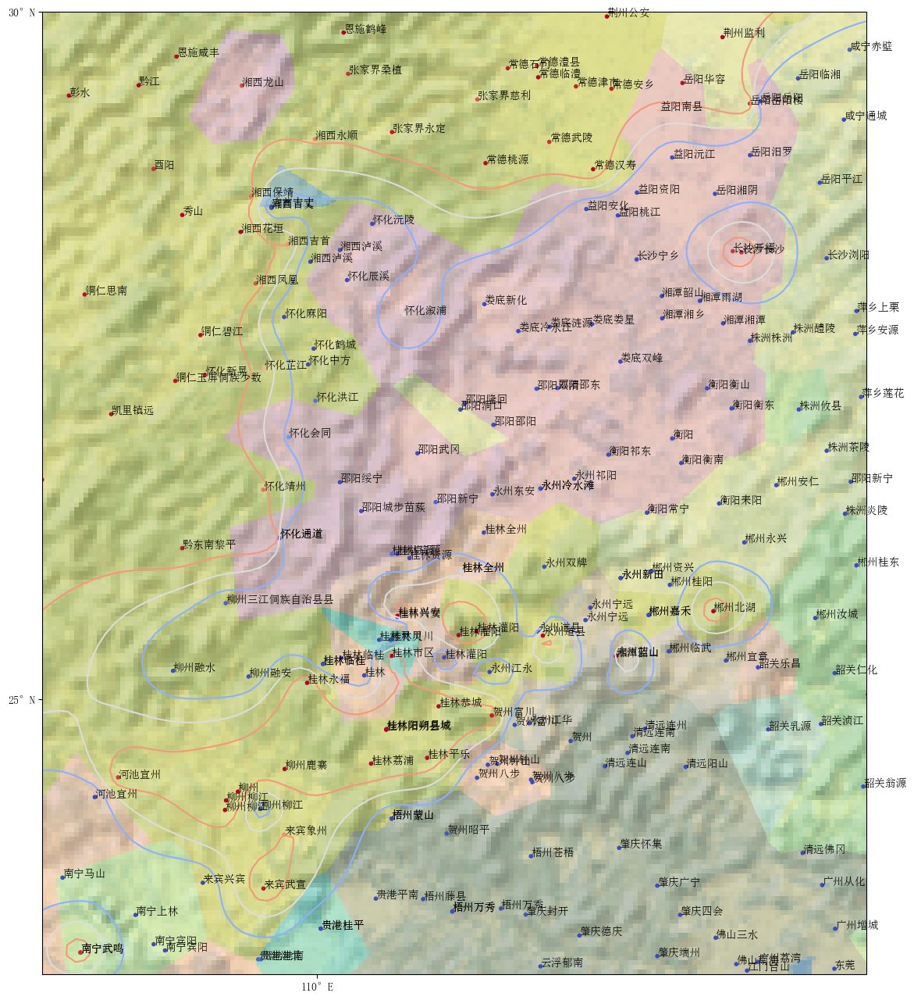

In [23]:
for extent in ([115, 122, 29, 34], [108, 114, 23, 30]):
    plt.figure(figsize=(16, 16))
    ax = plot_dialect(data, 'l2_all_beta_lr_prob', background, china.geometries(), extent=extent)
    for _, r in data[(data['longitude'] > extent[0]) \
        & (data['longitude'] < extent[1]) \
        & (data['latitude'] > extent[2]) \
        & (data['latitude'] < extent[3])].iterrows():
        ax.annotate(r['name'], xy=(r['longitude'], r['latitude']))
    plt.show()
    plt.close()